In [6]:
from scipy.spatial import Voronoi, voronoi_plot_2d, Delaunay, delaunay_plot_2d

import numpy as np
import csv
import matplotlib.pyplot as plt
import matplotlib.cm as cm
from matplotlib.cm import ScalarMappable
import matplotlib.tri as tri
plt.rcParams['figure.dpi'] = 360

from astropy.io import fits
from astropy.cosmology import WMAP9 as cosmo
from astropy.coordinates import SkyCoord
import astropy.units as u
import h5py
import time as t

In [3]:
rosettes = [3,6,7,11,12,13,14,15,18,19]

In [5]:
def graph_r(r):

    nodes = []
    edges = []
    edges_distances = []

    with open(f'./data/rosette{r}_nodes.csv', mode='r') as csv_file:
        csv_reader = csv.DictReader(csv_file)
        for row in csv_reader:
            if (row!=0):
                values = list(row.values())
                n = []
                n.append(float(values[0]))
                n.append(float(values[1]))
                n.extend(22.5-2.5*np.log10([float(n) for n in values[2:-1]]))
                n.append(np.log10(float(values[-1])))
                nodes.append(n)

    with open(f'./data/rosette{r}_edges.csv', mode='r') as csv_file:
        csv_reader = csv.DictReader(csv_file)
        for row in csv_reader:
            if (row!=0):
                edges_distances.append([float(n) for n in list(row.values())])
                edges.append([float(n) for n in list(row.values())][:2])

    return (nodes,edges,edges_distances)

### Write graph

In [7]:
def read_data_vd(r):
    hdu = fits.open('./data_vd/BGS_ANY_N_clustering.dat.fits')
    data_bgs = hdu[1].data
    data_prova = h5py.File('./data_vd/BGS_ANY_full.provabgs.sv3.v0.hdf5')
    dataset = data_prova['__astropy_table__']

    rosette_n = data_bgs[data_bgs['ROSETTE_NUMBER'] == r]
    ids = rosette_n['TARGETID']

    #filter by mass availability
    selected = [(row[0], row[15]) for row in dataset if row[0] in ids]

    #filter nodes data: [RA,DEC,d]
    mass = selected
    nodes = []

    for j in range(len(mass)):
        data_j = data_bgs[data_bgs['TARGETID'] == mass[j][0]]
        flux_w1 = data_j['FLUX_W1_DERED'][0]
        flux_w2 = data_j['FLUX_W2_DERED'][0]
        z = data_j['Z'][0]
        if (mass[j][1]>=0) and (flux_w1>=0) and (flux_w2>=0):
            RA = data_j['RA'][0]
            DEC = data_j['DEC'][0]
            d_n = cosmo.comoving_distance(data_j['Z'])
            nodes.append([RA, DEC, z])

    return nodes

In [5]:
def write_data(r, nodes):
    with open(f'./data_vd/rosette{r}_nodes.csv', mode='w', newline='') as csv_file:
        fieldnames = ['RA','DEC','Z']
        writer = csv.DictWriter(csv_file, fieldnames=fieldnames)
        writer.writeheader()
        for ra,dec,z in nodes:
            writer.writerow({
                'RA':ra,
                'DEC':dec,
                'Z':z
            })

In [99]:
for r in [3]:#rosettes:
    init = t.time()
    nodes = read_data_vd(r)
    write_data(r,nodes)
    end = t.time()
    print(f'time writing rosette_{r} csv: {round((end-init)/60,2)} m, {len(nodes)} nodes')

"for r in [3]:#rosettes:\n    init = t.time()\n    nodes = read_data_vd(r)\n    write_data(r,nodes)\n    end = t.time()\n    print(f'time writing rosette_{r} csv: {round((end-init)/60,2)} m, {len(nodes)} nodes')"

### Graph dv
nodes = [RA, DEC, d]

In [8]:
def graph_dv(r):

    nodes = []
    with open(f'./data_vd/rosette{r}_nodes.csv', mode='r') as csv_file:
        csv_reader = csv.DictReader(csv_file)
        for row in csv_reader:
            if (row!=0):
                nodes.append([float(n) for n in list(row.values())])
    return nodes

In [9]:
nodes = np.array(graph_dv(rosettes[0]))

### Voronoi diagram

Voronoi 2d (RA,DEC)

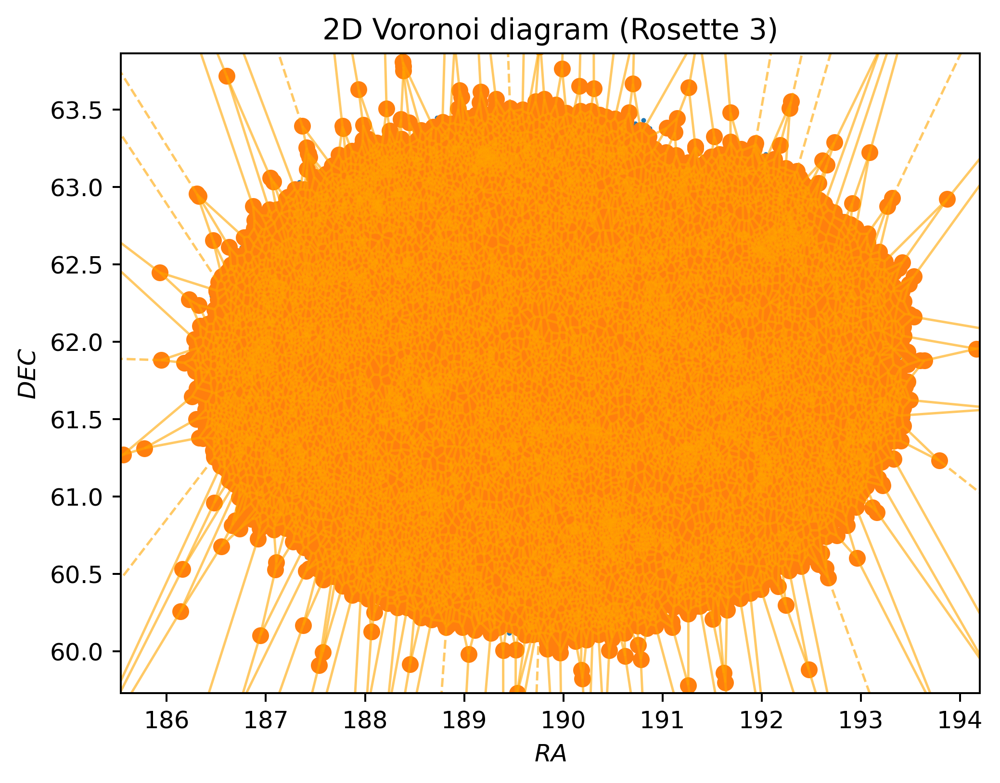

In [55]:
vor_2d = Voronoi(nodes[:,:2])
fig = voronoi_plot_2d(vor_2d, show_vertices=True, line_colors='orange',
                      lizne_width=2, line_alpha=0.6, point_size=2)
plt.title('2D Voronoi diagram (Rosette 3)')
plt.xlabel(r'$RA$',)
plt.ylabel(r'$DEC$')
plt.show()

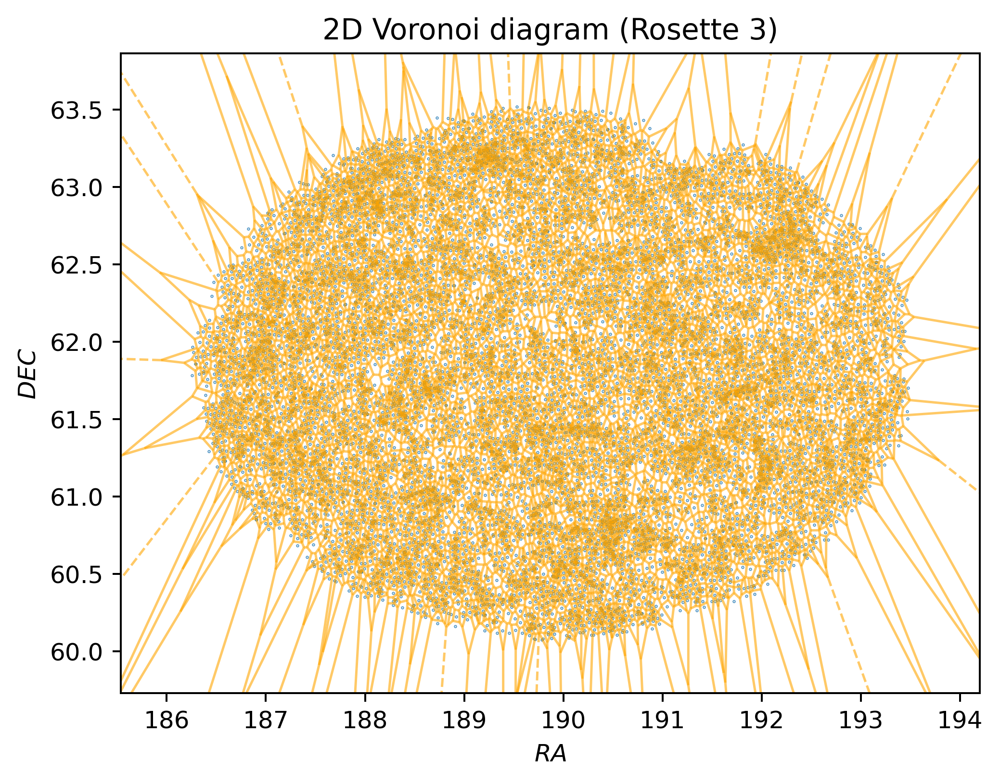

In [56]:
fig = voronoi_plot_2d(vor_2d, show_vertices=False, line_colors='orange',
                      lizne_width=2, line_alpha=0.6, point_size=0.5)
plt.title('2D Voronoi diagram (Rosette 3)')
plt.xlabel(r'$RA$',)
plt.ylabel(r'$DEC$')
plt.show()

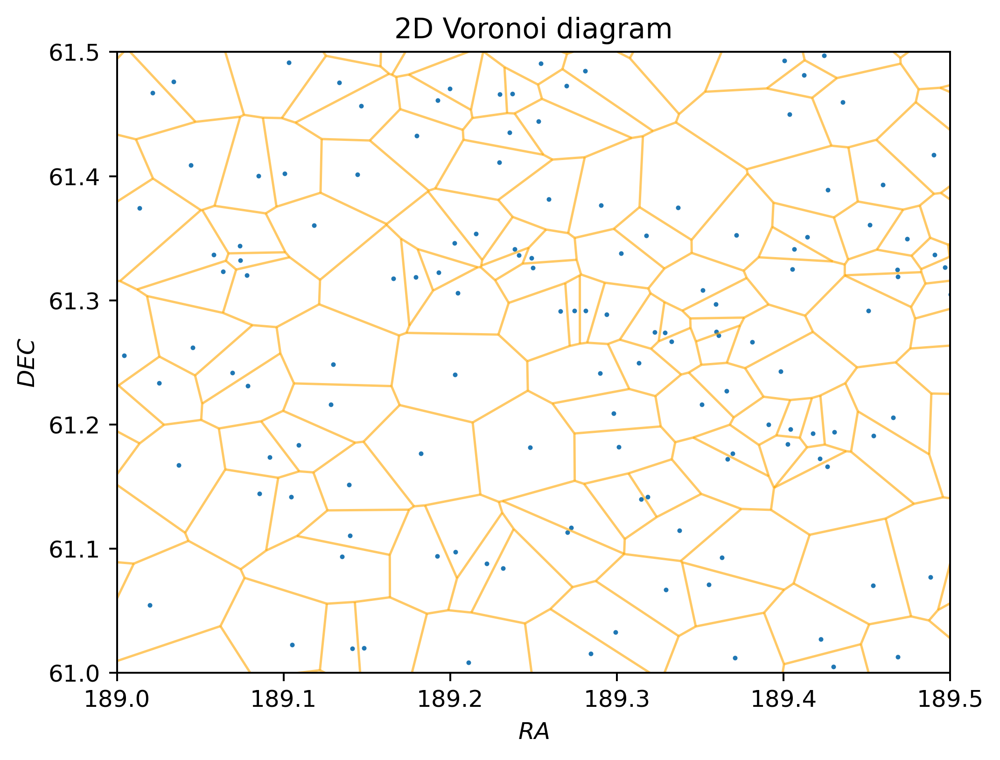

In [8]:
fig = voronoi_plot_2d(vor_2d, show_vertices=False, line_colors='orange',
                      lizne_width=2, line_alpha=0.6, point_size=2)
plt.title('2D Voronoi diagram (Rosette 3)')
plt.xlabel(r'$RA$',)
plt.ylabel(r'$DEC$')
plt.xlim([189,189.5])
plt.ylim([61,61.5])
plt.show()

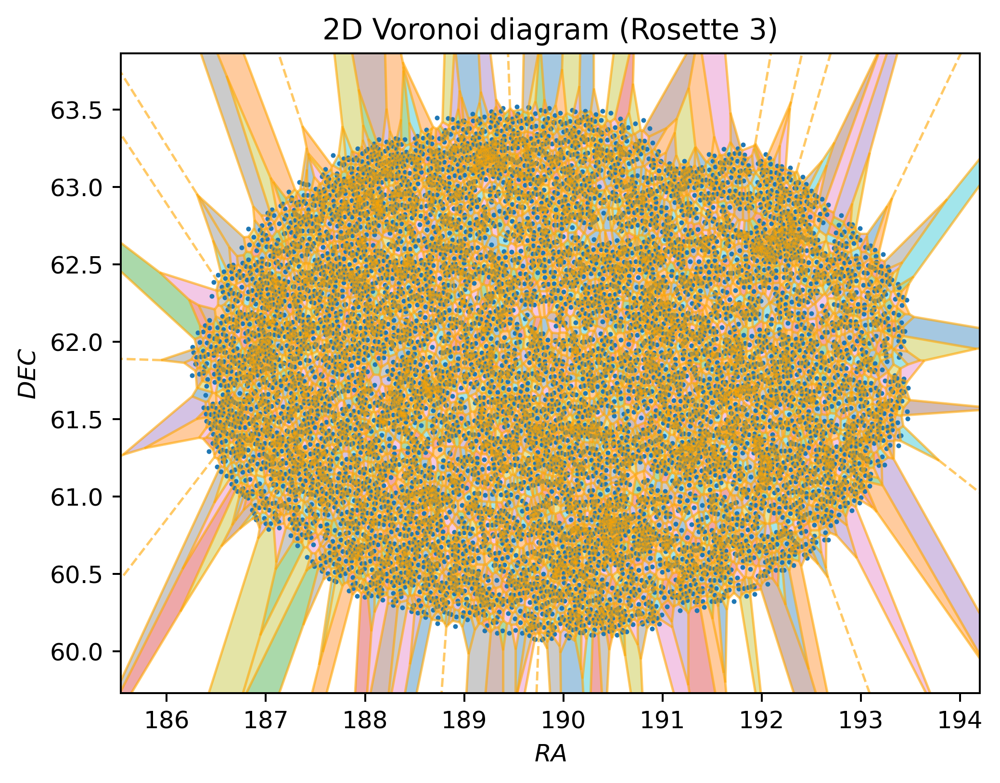

In [57]:
vor_2d = Voronoi(nodes[:,:2])
fig = voronoi_plot_2d(vor_2d, show_vertices=False, line_colors='orange', lizne_width=2, line_alpha=0.6, point_size=2)

for region in vor_2d.regions:
    if not -1 in region:# and len(region) > 0:
        polygon = [vor_2d.vertices[i] for i in region]
        plt.fill(*zip(*polygon), alpha=0.4)
plt.title('2D Voronoi diagram (Rosette 3)')
plt.xlabel(r'$RA$',)
plt.ylabel(r'$DEC$')
plt.show()

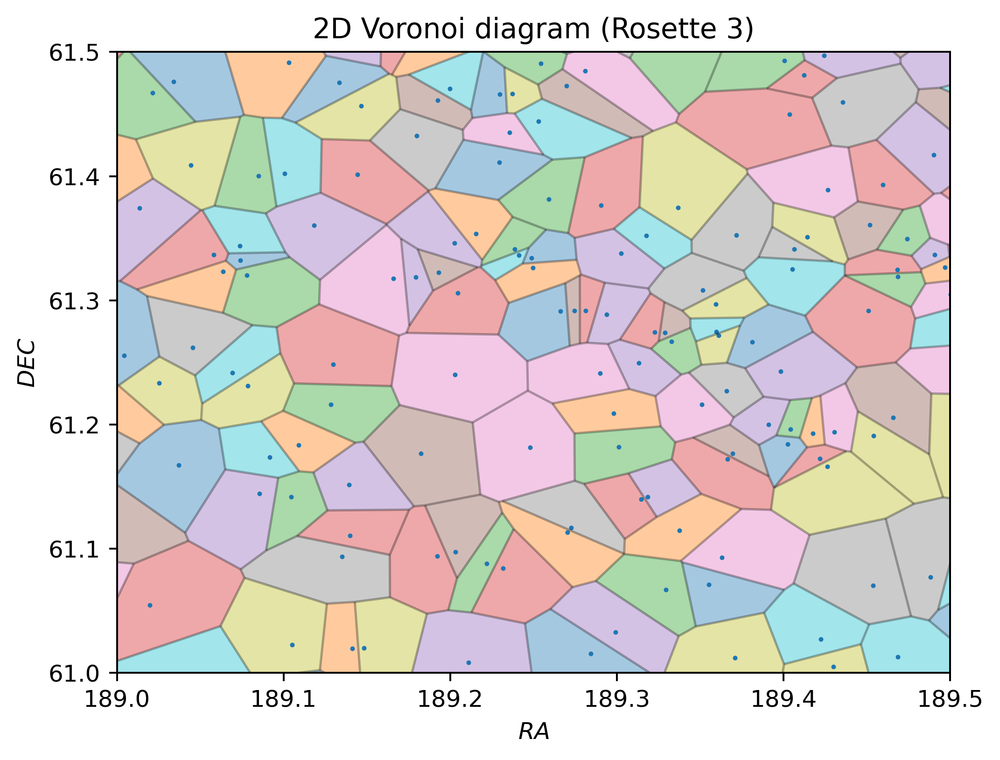

In [58]:
fig = voronoi_plot_2d(vor_2d, show_vertices=False, line_colors='black', lizne_width=2, line_alpha=0.3, point_size=2)

for region in vor_2d.regions:
    if not -1 in region and len(region) > 0:
        polygon = [vor_2d.vertices[i] for i in region]
        plt.fill(*zip(*polygon), alpha=0.4)

plt.title('2D Voronoi diagram (Rosette 3)')
plt.xlabel(r'$RA$',)
plt.ylabel(r'$DEC$')
plt.xlim([189,189.5])
plt.ylim([61,61.5])
plt.show()

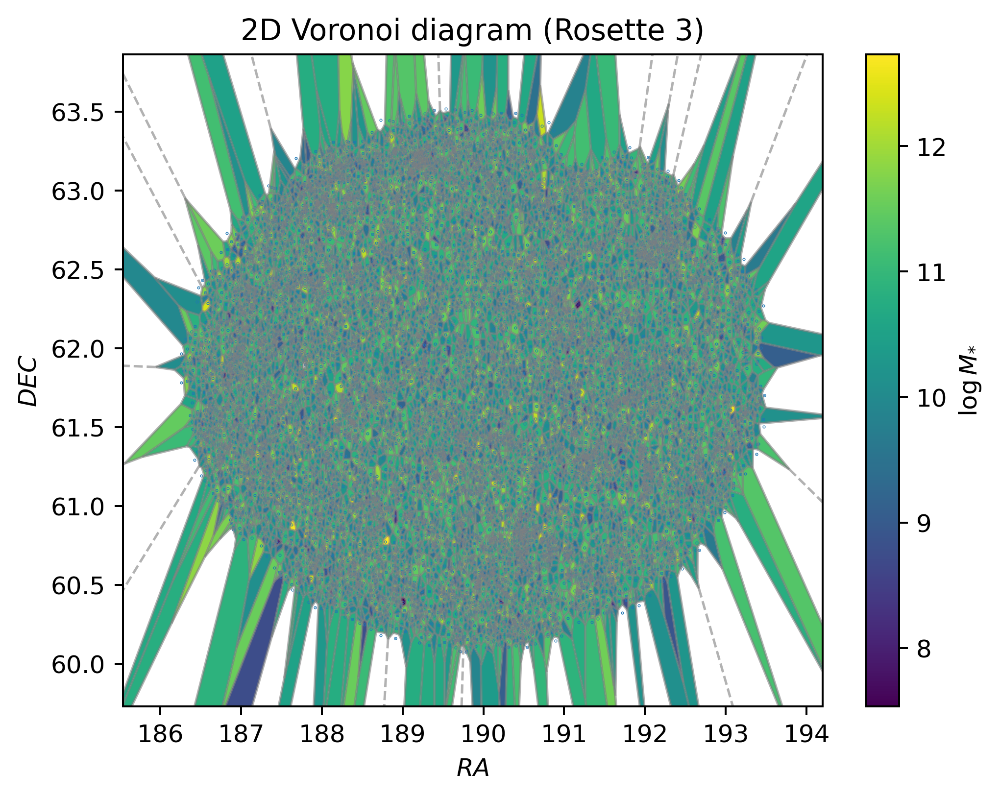

In [59]:
coord = np.array(graph_dv(rosettes[0]))[:,:2]
n, _, _ = graph_r(rosettes[0])
masas = np.array([node[1] for node in n])

vor = Voronoi(coord)
fig, ax = plt.subplots()

norm = plt.Normalize(vmin=masas.min(), vmax=masas.max())
colormap = plt.cm.viridis
sm = ScalarMappable(cmap=colormap, norm=norm)
sm.set_array([])
cbar = plt.colorbar(sm, ax=ax, label=r'$\log M_{*}$')

voronoi_plot_2d(vor, ax=ax, show_vertices=False, line_colors='grey', lizne_width=2, line_alpha=0.6, point_size=0.5)


for i, region in enumerate(vor.regions):
    if (not -1 in region) and (len(region) > 0) and (i < len(masas)):
        polygon = [vor.vertices[j] for j in region]
        poly = plt.Polygon(polygon)
        poly.set_facecolor(colormap(norm(masas[i])))
        ax.add_patch(poly)

ax.set_xlabel(r'$RA$',)
ax.set_ylabel(r'$DEC$')
plt.title('2D Voronoi diagram (Rosette 3)')
plt.show()

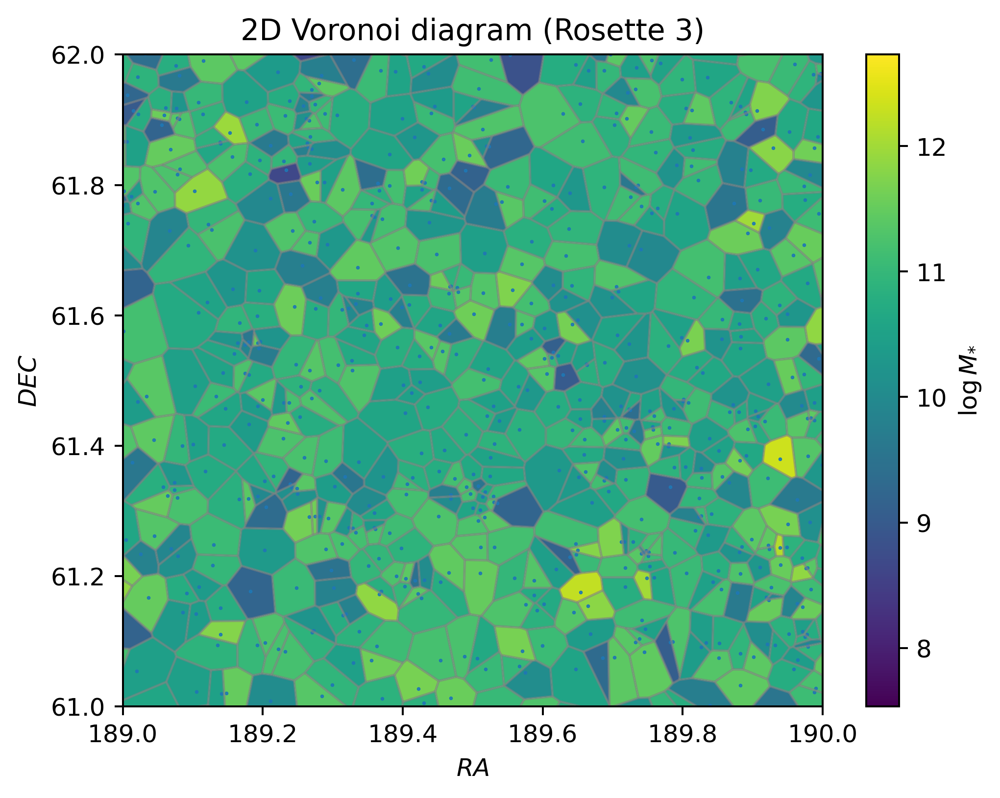

In [60]:
coord = np.array(graph_dv(rosettes[0]))[:,:2]
n, _, _ = graph_r(rosettes[0])
masas = np.array([node[1] for node in n])

vor = Voronoi(coord)
fig, ax = plt.subplots()

norm = plt.Normalize(vmin=masas.min(), vmax=masas.max())
colormap = plt.cm.viridis
sm = ScalarMappable(cmap=colormap, norm=norm)
sm.set_array([])
cbar = plt.colorbar(sm, ax=ax, label=r'$\log M_{*}$')

voronoi_plot_2d(vor, ax=ax, show_vertices=False, line_colors='grey', lizne_width=2, line_alpha=0.6, point_size=1)


for i, region in enumerate(vor.regions):
    if (not -1 in region) and (len(region) > 0) and (i < len(masas)):
        polygon = [vor.vertices[j] for j in region]
        poly = plt.Polygon(polygon)
        poly.set_facecolor(colormap(norm(masas[i])))
        ax.add_patch(poly)

ax.set_xlabel(r'$RA$',)
ax.set_ylabel(r'$DEC$')
plt.xlim([189,190])
plt.ylim([61,62])
plt.title('2D Voronoi diagram (Rosette 3)')
plt.show()

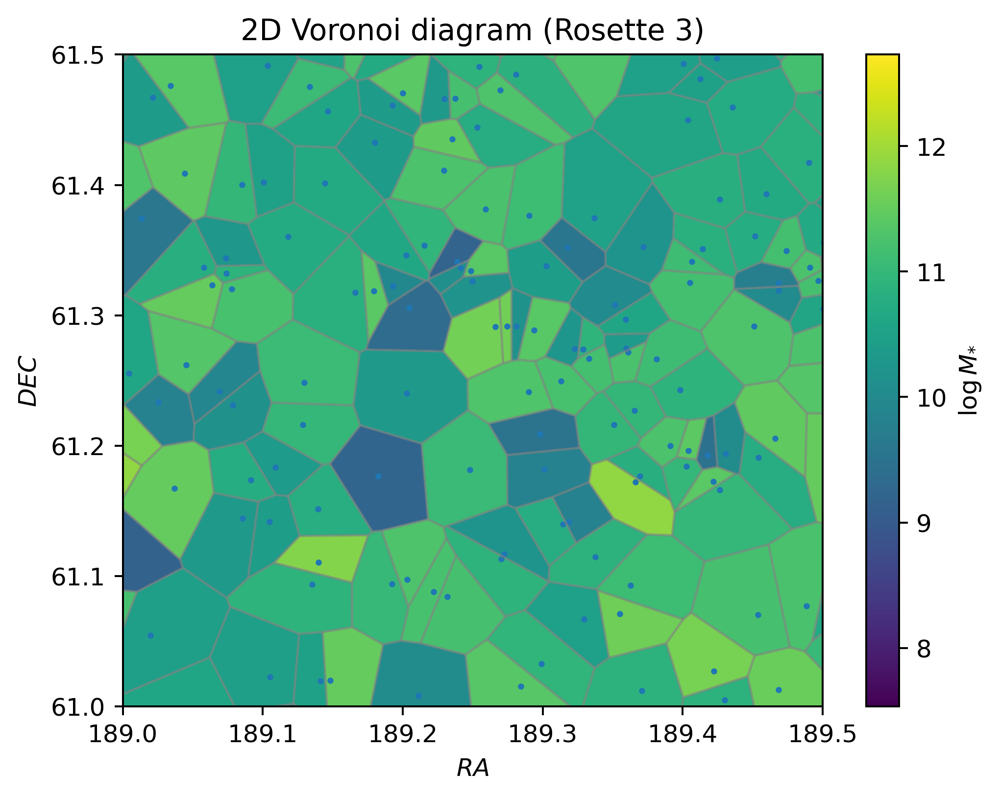

In [61]:
coord = np.array(graph_dv(rosettes[0]))[:,:2]
n, _, _ = graph_r(rosettes[0])
masas = np.array([node[1] for node in n])

vor = Voronoi(coord)
fig, ax = plt.subplots()

norm = plt.Normalize(vmin=masas.min(), vmax=masas.max())
colormap = plt.cm.viridis
sm = ScalarMappable(cmap=colormap, norm=norm)
sm.set_array([])
cbar = plt.colorbar(sm, ax=ax, label=r'$\log M_{*}$')

voronoi_plot_2d(vor, ax=ax, show_vertices=False, line_colors='grey', lizne_width=2, line_alpha=0.6, point_size=3)


for i, region in enumerate(vor.regions):
    if (not -1 in region) and (len(region) > 0) and (i < len(masas)):
        polygon = [vor.vertices[j] for j in region]
        poly = plt.Polygon(polygon)
        poly.set_facecolor(colormap(norm(masas[i])))
        ax.add_patch(poly)

ax.set_xlabel(r'$RA$',)
ax.set_ylabel(r'$DEC$')
plt.xlim([189,189.5])
plt.ylim([61,61.5])
plt.title('2D Voronoi diagram (Rosette 3)')
plt.show()

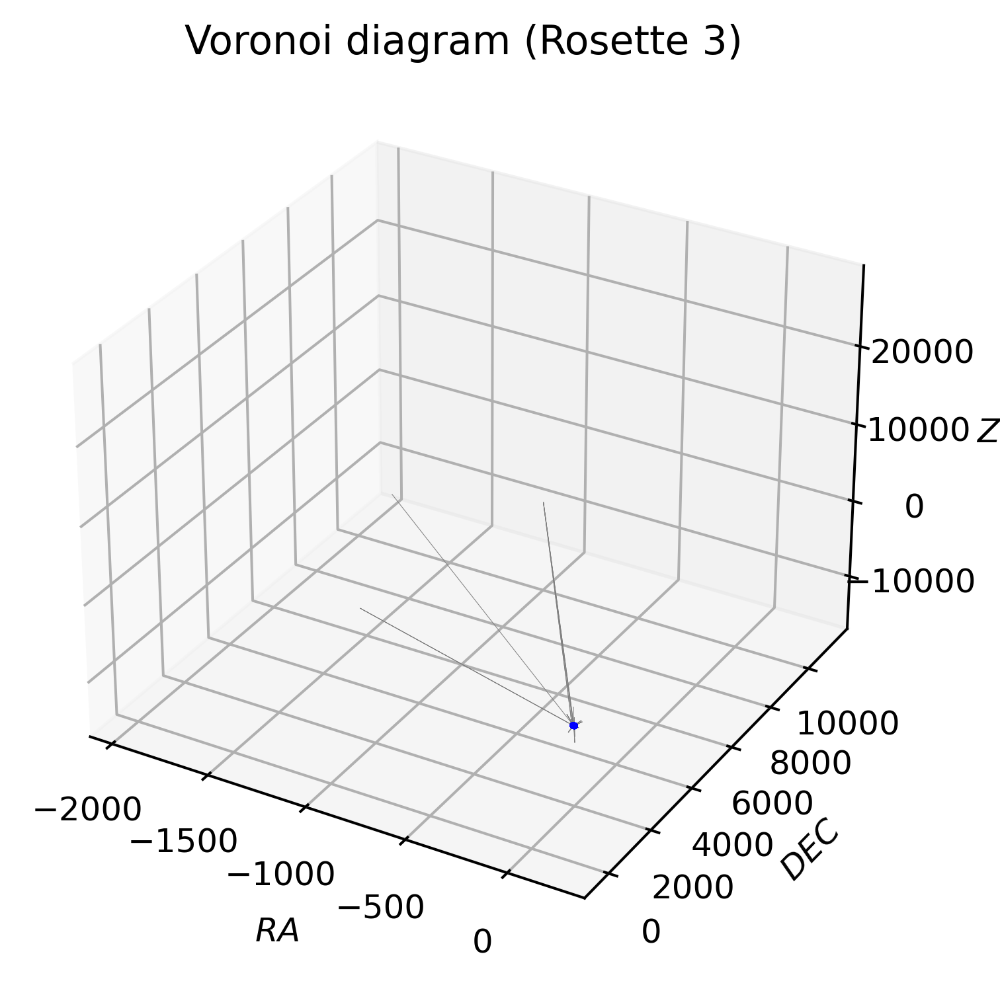

In [107]:
vor = Voronoi(nodes)
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

ax.scatter(nodes[:,0], nodes[:,1], nodes[:,2], s=1, color='blue')

for simplex in vor.ridge_vertices:
    simplex = np.asarray(simplex)
    if np.all(simplex >= 0):
        #ax.scatter(vor.vertices[simplex, 0], vor.vertices[simplex, 1], vor.vertices[simplex, 2], color='red', s=0.2)
        ax.plot(vor.vertices[simplex, 0], vor.vertices[simplex, 1], vor.vertices[simplex, 2], color='grey', linewidth=0.2)

ax.set_title('Voronoi diagram (Rosette 3)')
ax.set_xlabel(r'$RA$',)
ax.set_ylabel(r'$DEC$')
ax.set_zlabel(r'$Z$')
plt.show()

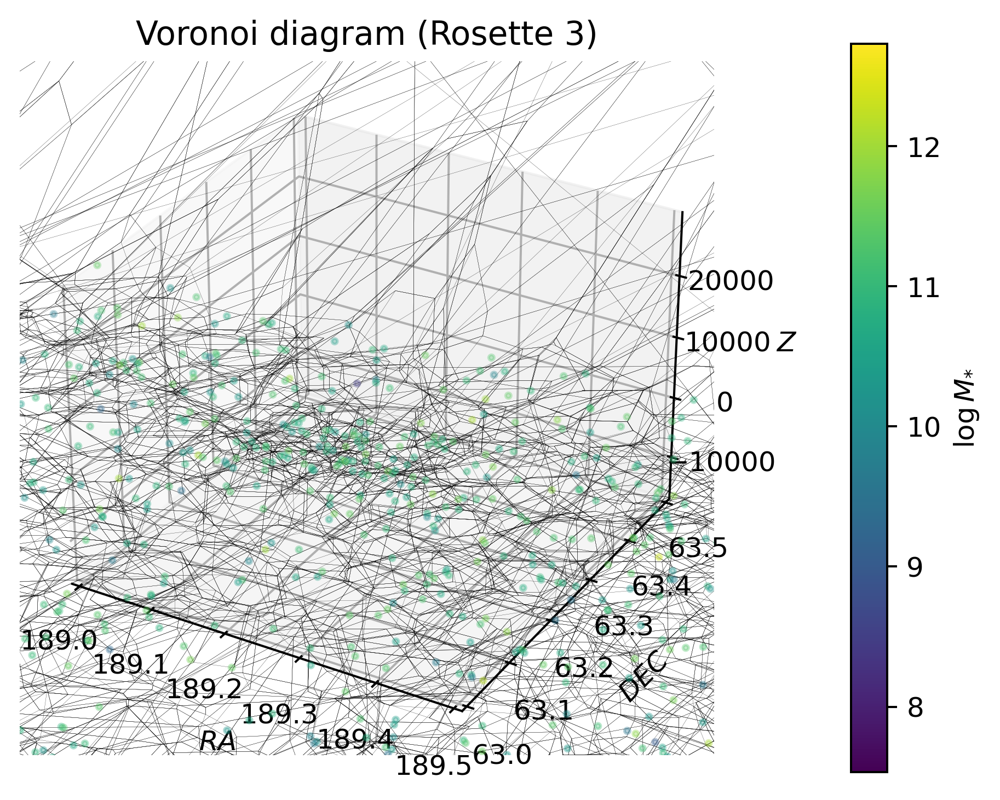

In [133]:
vor = Voronoi(nodes)
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

n, _, _ = graph_r(rosettes[0])
cmap = cm.viridis
c_values = np.array([node[1] for node in n])
min_norm = np.min(c_values)
max_norm = np.max(c_values)
sm = ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin=min_norm, vmax=max_norm))
sm.set_array([])

ax.scatter(nodes[:,0], nodes[:,1], nodes[:,2], c=cmap(norm), s=4)

for simplex in vor.ridge_vertices:
    simplex = np.asarray(simplex)
    if np.all(simplex >= 0):
        #ax.scatter(vor.vertices[simplex, 0], vor.vertices[simplex, 1], vor.vertices[simplex, 2], color='red', s=0.2)
        ax.plot(vor.vertices[simplex, 0], vor.vertices[simplex, 1], vor.vertices[simplex, 2], color='black', linewidth=0.06)

plt.xlim([189,189.5])
plt.ylim([63,63.5])

cbar = plt.colorbar(sm, ax=ax, pad=0.14)
cbar.set_label(r'$\log M_{*}$')

ax.set_title('Voronoi diagram (Rosette 3)')
ax.set_xlabel(r'$RA$',)
ax.set_ylabel(r'$DEC$')
ax.set_zlabel(r'$Z$')
plt.show()

### Delaunay triangulations

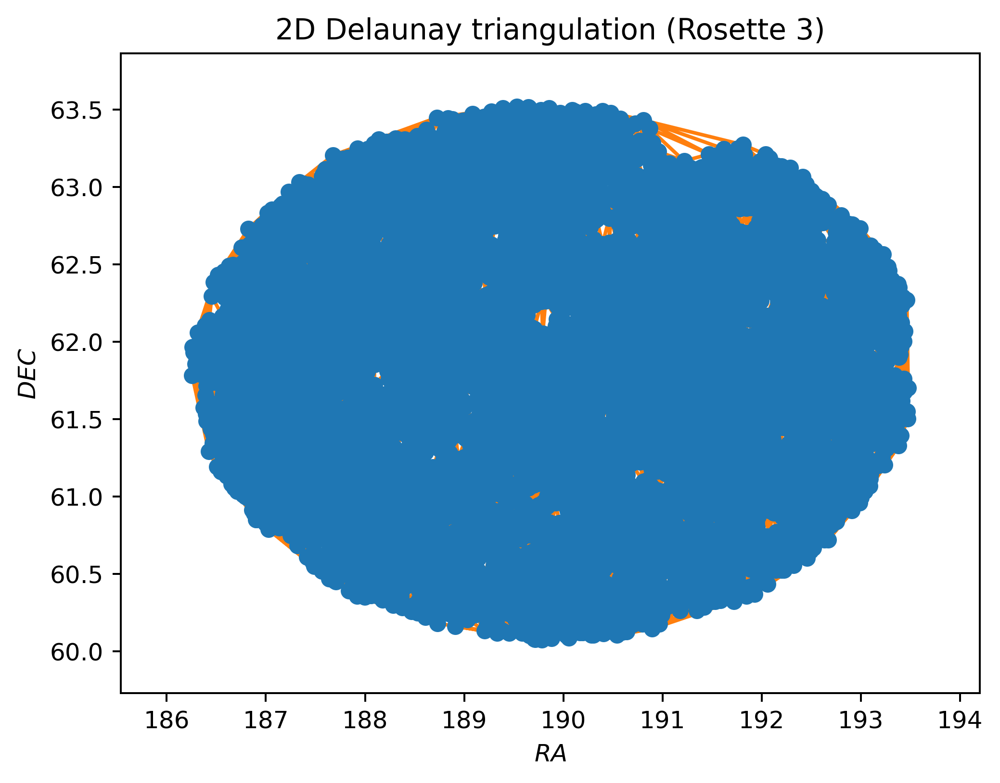

In [62]:
triangulation = Delaunay(nodes[:,:2])

_ = delaunay_plot_2d(triangulation)
plt.title('2D Delaunay triangulation (Rosette 3)')
plt.xlabel(r'$RA$',)
plt.ylabel(r'$DEC$')
plt.show()

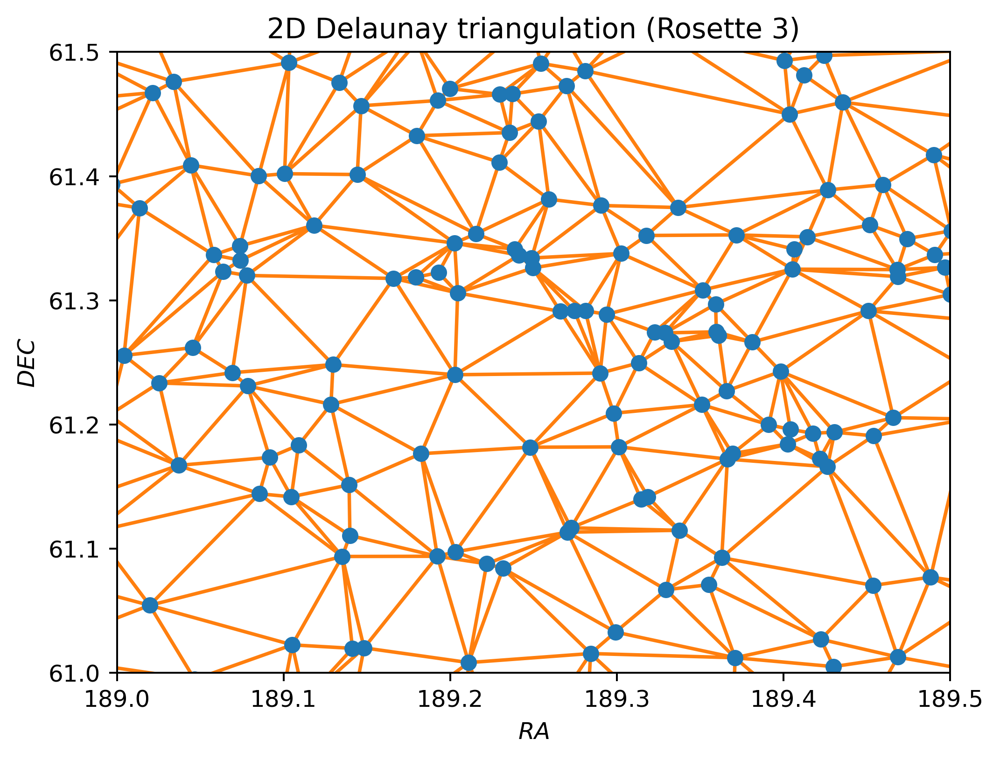

In [63]:
triangulation = Delaunay(nodes[:,:2])
_ = delaunay_plot_2d(triangulation)

plt.title('2D Delaunay triangulation (Rosette 3)')
plt.xlabel(r'$RA$',)
plt.ylabel(r'$DEC$')
plt.xlim([189,189.5])
plt.ylim([61,61.5])
plt.show()

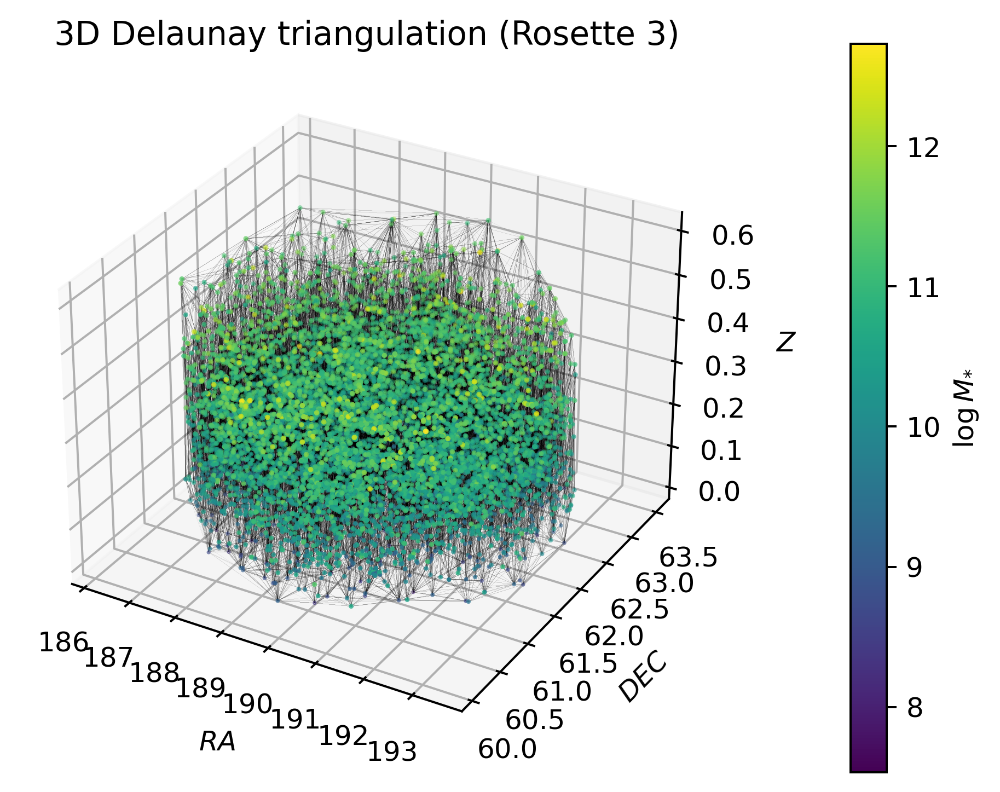

In [64]:
n, _, _ = graph_r(rosettes[0])
cmap = cm.viridis
c_values = np.array([node[1] for node in n])
norm = (c_values - np.min(c_values)) / (np.max(c_values) - np.min(c_values))
min_norm = np.min(c_values)
max_norm = np.max(c_values)
sm = ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin=min_norm, vmax=max_norm))
sm.set_array([])

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
t_3d = Delaunay(nodes)

ax.scatter(nodes[:,0], nodes[:,1], nodes[:,2], c=cmap(norm), s=norm)
for simplex in t_3d.simplices:
    simplex = np.append(simplex, simplex[0])
    ax.plot(nodes[simplex, 0], nodes[simplex, 1], nodes[simplex, 2], color='black', linewidth=0.01)

cbar = plt.colorbar(sm, ax=ax, pad=0.14)
cbar.set_label(r'$\log M_{*}$')

ax.set_title('3D Delaunay triangulation (Rosette 3)')
ax.set_xlabel(r'$RA$',)
ax.set_ylabel(r'$DEC$')
ax.set_zlabel(r'$Z$')
plt.show()

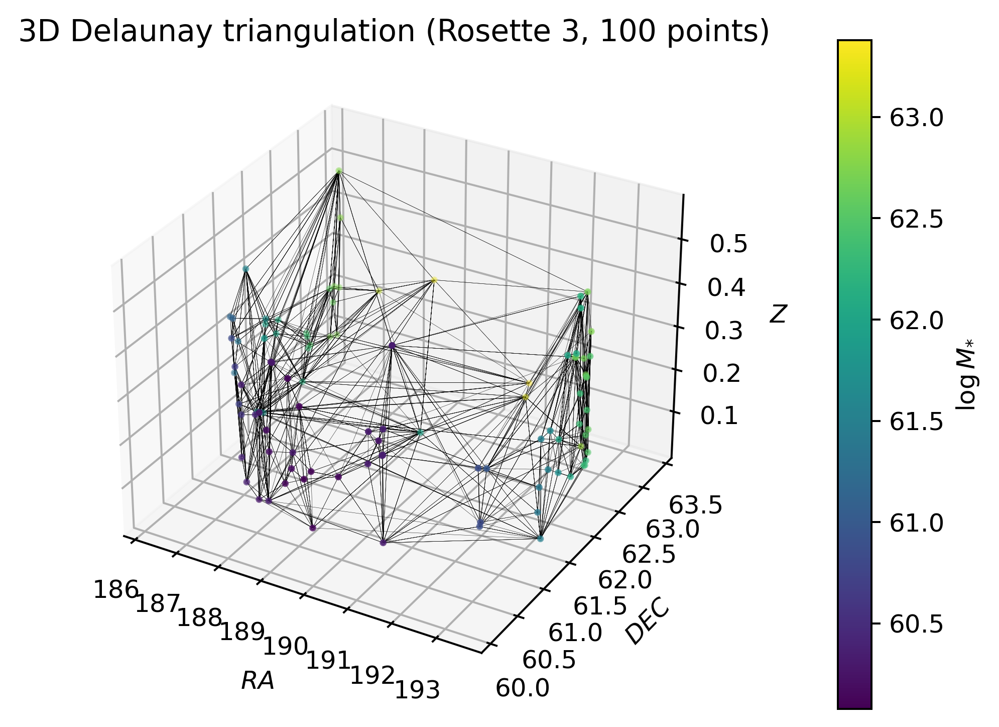

In [17]:
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
n = nodes[:100]
t_3d = Delaunay(n)

c_values = np.array([node[1] for node in n])[:100]
min_norm = np.min(c_values)
max_norm = np.max(c_values)
norm = (c_values - np.min(c_values)) / (np.max(c_values) - np.min(c_values))
sm = ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin=min_norm, vmax=max_norm))
sm.set_array([])

ax.scatter(n[:,0], n[:,1], n[:,2], c=cmap(norm), s=3)
for simplex in t_3d.simplices:
    simplex = np.append(simplex, simplex[0])
    ax.plot(n[simplex, 0], n[simplex, 1], n[simplex, 2], color='black', linewidth=0.1)

cbar = plt.colorbar(sm, ax=ax, pad=0.14)
cbar.set_label(r'$\log M_{*}$')
ax.set_title('3D Delaunay triangulation (Rosette 3, 100 points)')
ax.set_xlabel(r'$RA$',)
ax.set_ylabel(r'$DEC$')
ax.set_zlabel(r'$Z$')
plt.show()

### Voronoi-Delaunay

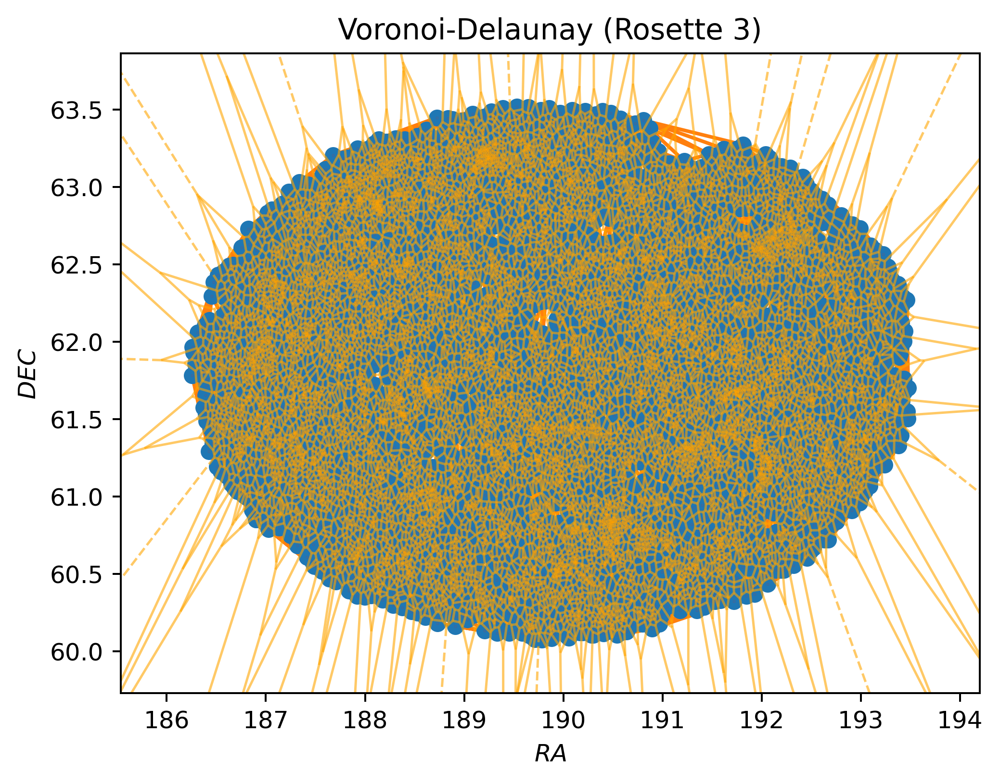

In [65]:
fig = plt.figure()
ax = fig.add_subplot(111)

triangulation = Delaunay(nodes[:,:2])
delaunay_plot_2d(triangulation, ax)
voronoi_plot_2d(vor_2d, show_vertices=False, line_colors='orange', lizne_width=2, line_alpha=0.6, point_size=0.1, ax=ax)
plt.title('Voronoi-Delaunay (Rosette 3)')
ax.set_xlabel(r'$RA$',)
ax.set_ylabel(r'$DEC$')
plt.show()

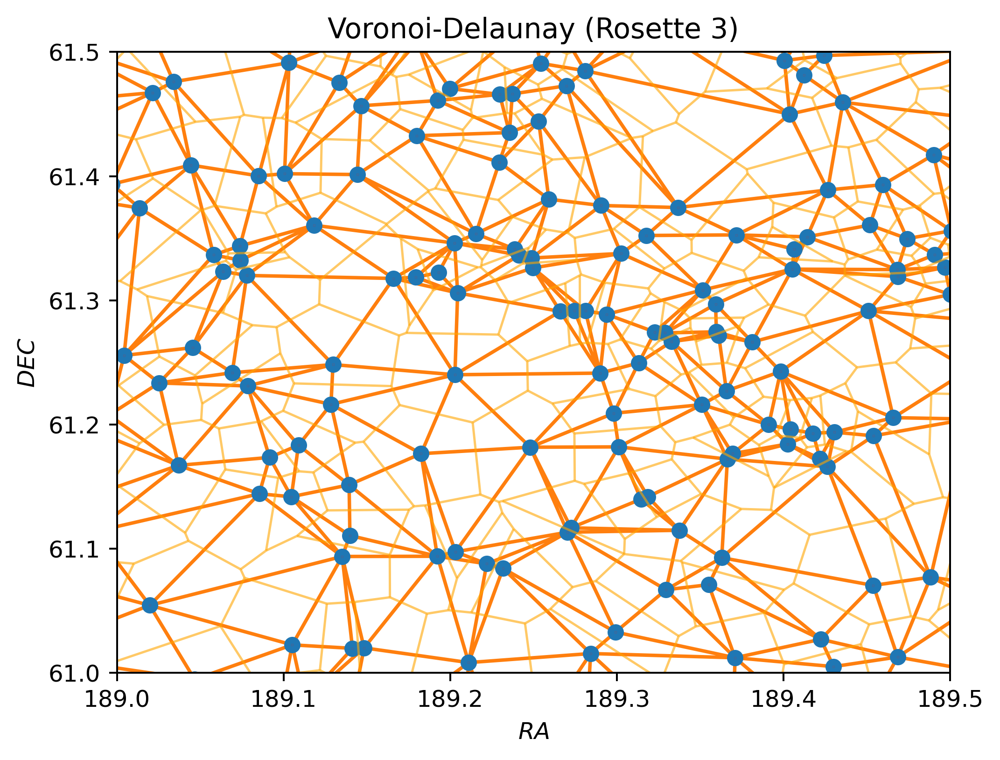

In [66]:
fig = plt.figure()
ax = fig.add_subplot(111)

triangulation = Delaunay(nodes[:,:2])
delaunay_plot_2d(triangulation, ax)
voronoi_plot_2d(vor_2d, show_vertices=False, line_colors='orange', lizne_width=2, line_alpha=0.6, point_size=0.1, ax=ax)
plt.xlim([189,189.5])
plt.ylim([61,61.5])
plt.title('Voronoi-Delaunay (Rosette 3)')
ax.set_xlabel(r'$RA$',)
ax.set_ylabel(r'$DEC$')
plt.show()

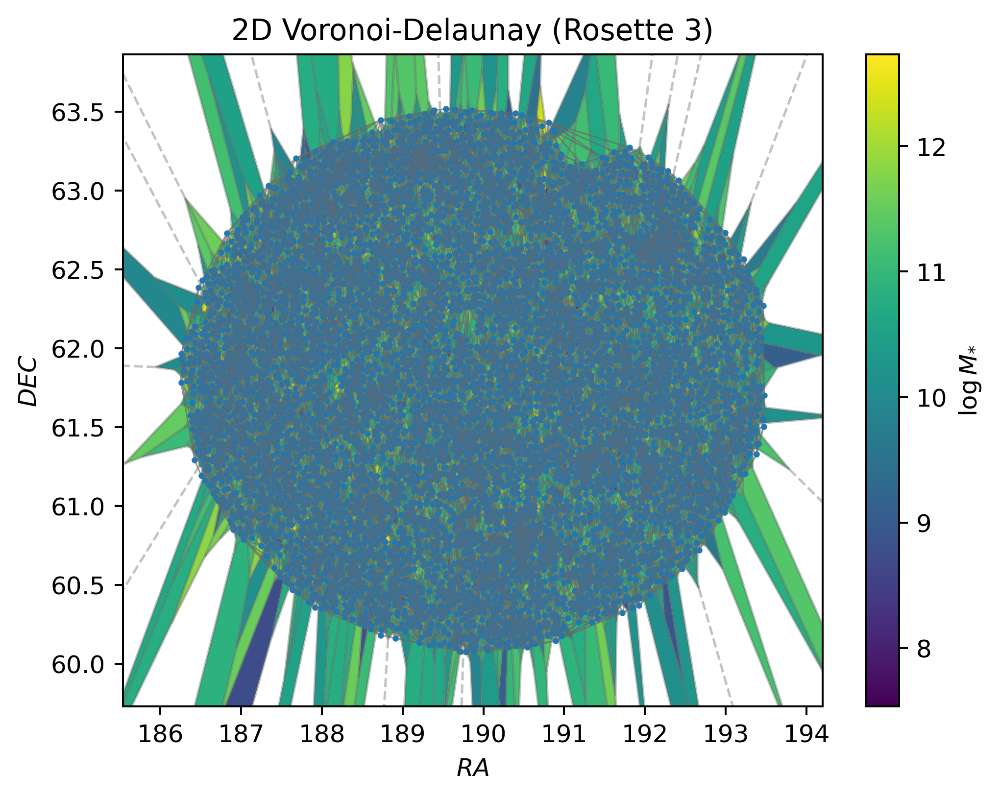

In [67]:
coord = np.array(graph_dv(rosettes[0]))[:,:2]
n, _, _ = graph_r(rosettes[0])
masas = np.array([node[1] for node in n])

vor = Voronoi(coord)
fig, ax = plt.subplots()

norm = plt.Normalize(vmin=masas.min(), vmax=masas.max())
colormap = plt.cm.viridis
sm = ScalarMappable(cmap=colormap, norm=norm)
sm.set_array([])
cbar = plt.colorbar(sm, ax=ax, label=r'$\log M_{*}$')

#Voronoi diagram with mass colormap
voronoi_plot_2d(vor, ax=ax, show_vertices=False, line_colors='dimgrey', lizne_width=2, line_alpha=0.4, point_size=3)
for i, region in enumerate(vor.regions):
    if (not -1 in region) and (len(region) > 0) and (i < len(masas)):
        polygon = [vor.vertices[j] for j in region]
        poly = plt.Polygon(polygon)
        poly.set_facecolor(colormap(norm(masas[i])))
        ax.add_patch(poly)

#Delaunay triangulation
triangulation = Delaunay(coord)
ax.triplot(coord[:,0], coord[:,1], triangulation.simplices, color='dimgray', alpha=0.7, linewidth=0.6)

plt.title('2D Voronoi-Delaunay (Rosette 3)')
ax.set_xlabel(r'$RA$',)
ax.set_ylabel(r'$DEC$')
plt.show()

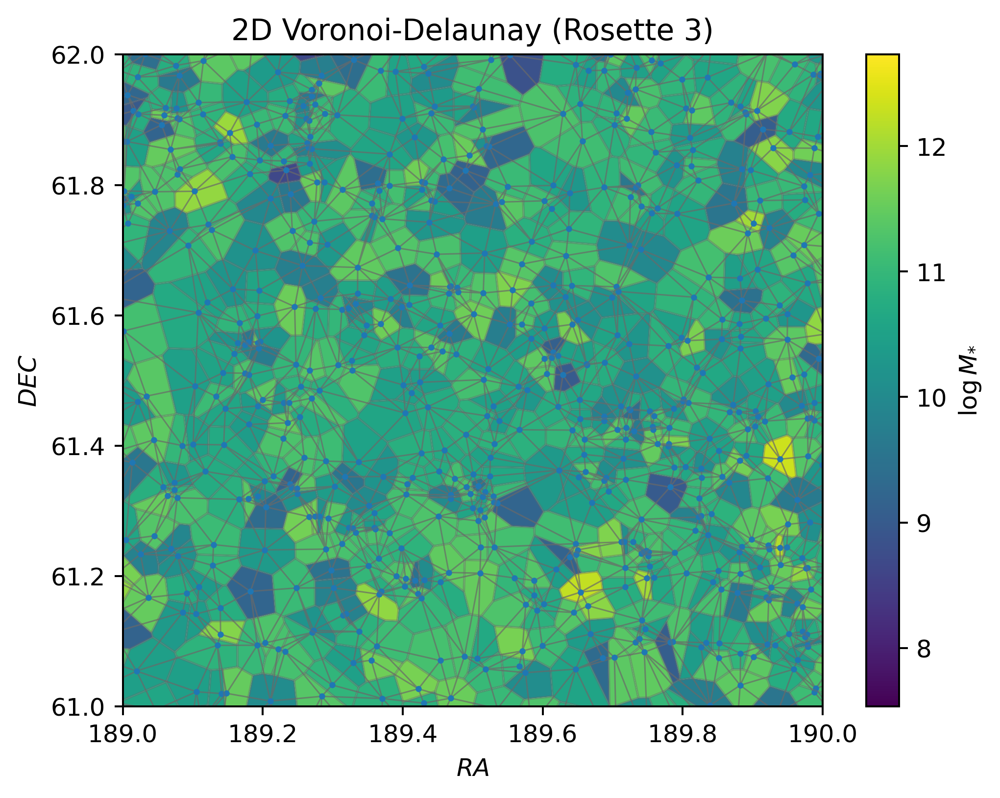

In [68]:
coord = np.array(graph_dv(rosettes[0]))[:,:2]
n, _, _ = graph_r(rosettes[0])
masas = np.array([node[1] for node in n])

vor = Voronoi(coord)
fig, ax = plt.subplots()

norm = plt.Normalize(vmin=masas.min(), vmax=masas.max())
colormap = plt.cm.viridis
sm = ScalarMappable(cmap=colormap, norm=norm)
sm.set_array([])
cbar = plt.colorbar(sm, ax=ax, label=r'$\log M_{*}$')

#Voronoi diagram with mass colormap
voronoi_plot_2d(vor, ax=ax, show_vertices=False, line_colors='dimgrey', lizne_width=2, line_alpha=0.4, point_size=3)
for i, region in enumerate(vor.regions):
    if (not -1 in region) and (len(region) > 0) and (i < len(masas)):
        polygon = [vor.vertices[j] for j in region]
        poly = plt.Polygon(polygon)
        poly.set_facecolor(colormap(norm(masas[i])))
        ax.add_patch(poly)

#Delaunay triangulation
triangulation = Delaunay(coord)
ax.triplot(coord[:,0], coord[:,1], triangulation.simplices, color='dimgray', alpha=0.7, linewidth=0.6)

plt.xlim([189,190])
plt.ylim([61,62])
plt.title('2D Voronoi-Delaunay (Rosette 3)')
ax.set_xlabel(r'$RA$',)
ax.set_ylabel(r'$DEC$')
plt.show()

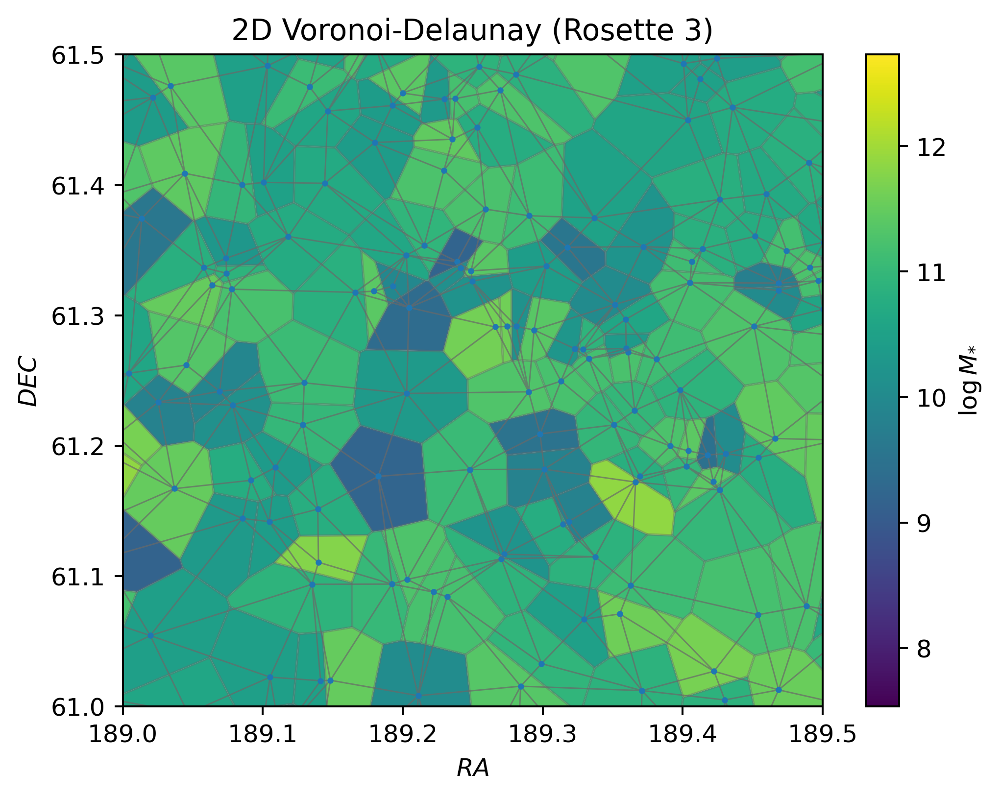

In [69]:
coord = np.array(graph_dv(rosettes[0]))[:,:2]
n, _, _ = graph_r(rosettes[0])
masas = np.array([node[1] for node in n])

vor = Voronoi(coord)
fig, ax = plt.subplots()

norm = plt.Normalize(vmin=masas.min(), vmax=masas.max())
colormap = plt.cm.viridis
sm = ScalarMappable(cmap=colormap, norm=norm)
sm.set_array([])
cbar = plt.colorbar(sm, ax=ax, label=r'$\log M_{*}$')

#Voronoi diagram with mass colormap
voronoi_plot_2d(vor, ax=ax, show_vertices=False, line_colors='dimgrey', lizne_width=2, line_alpha=0.4, point_size=3)
for i, region in enumerate(vor.regions):
    if (not -1 in region) and (len(region) > 0) and (i < len(masas)):
        polygon = [vor.vertices[j] for j in region]
        poly = plt.Polygon(polygon)
        poly.set_facecolor(colormap(norm(masas[i])))
        ax.add_patch(poly)

#Delaunay triangulation
triangulation = Delaunay(coord)
ax.triplot(coord[:,0], coord[:,1], triangulation.simplices, color='dimgray', alpha=0.7, linewidth=0.6)

plt.xlim([189,189.5])
plt.ylim([61,61.5])
plt.title('2D Voronoi-Delaunay (Rosette 3)')
ax.set_xlabel(r'$RA$',)
ax.set_ylabel(r'$DEC$')
plt.show()

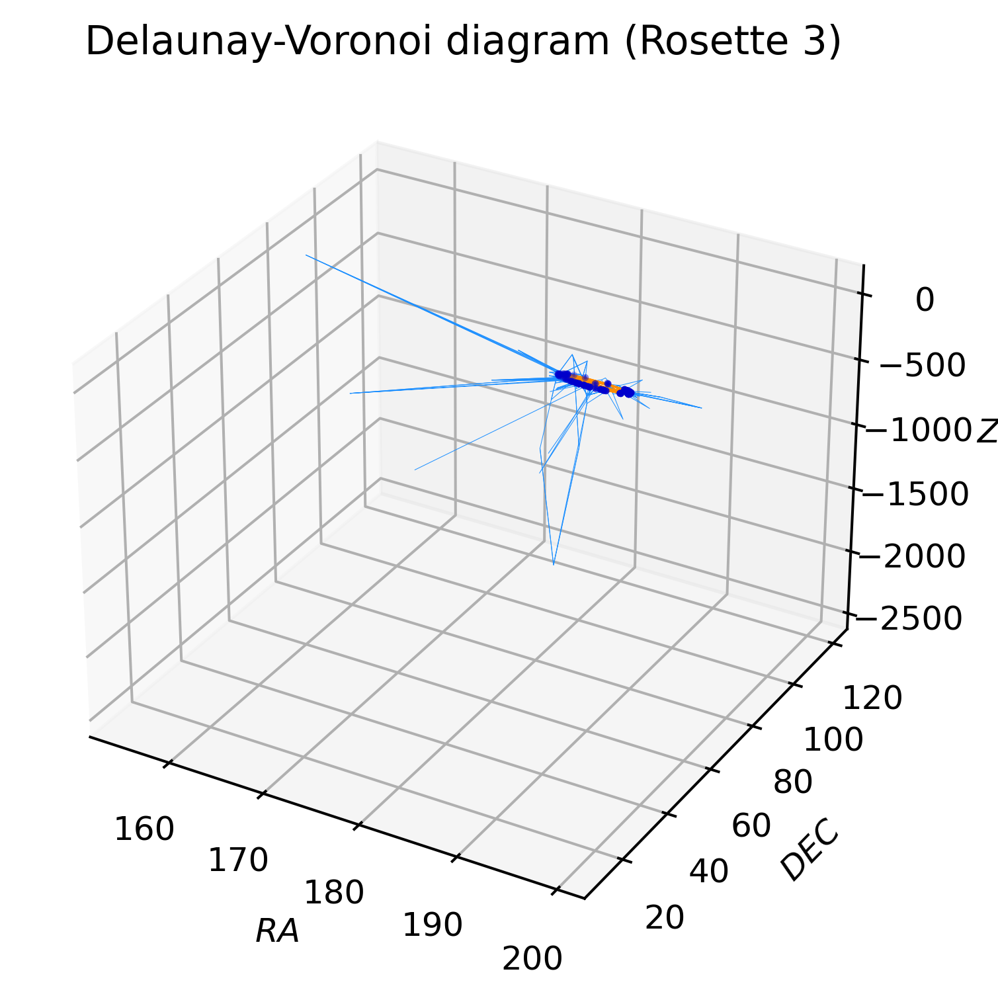

In [115]:
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
n = nodes[:100]

ax.scatter(n[:,0], n[:,1], n[:,2], s=1.2, color='mediumblue')

vor_3d = Voronoi(n)
for simplex in vor_3d.ridge_vertices:
    simplex = np.asarray(simplex)
    if np.all(simplex >= 0):
        ax.plot(vor_3d.vertices[simplex, 0], vor_3d.vertices[simplex, 1], vor_3d.vertices[simplex, 2], color='dodgerblue', linewidth=0.2)

t_3d = Delaunay(n)
for simplex in t_3d.simplices:
    simplex = np.append(simplex, simplex[0])
    ax.plot(n[simplex, 0], n[simplex, 1], n[simplex, 2], color='darkorange', linewidth=0.2)

ax.set_title('Delaunay-Voronoi diagram (Rosette 3)')
ax.set_xlabel(r'$RA$',)
ax.set_ylabel(r'$DEC$')
ax.set_zlabel(r'$Z$')

plt.show()

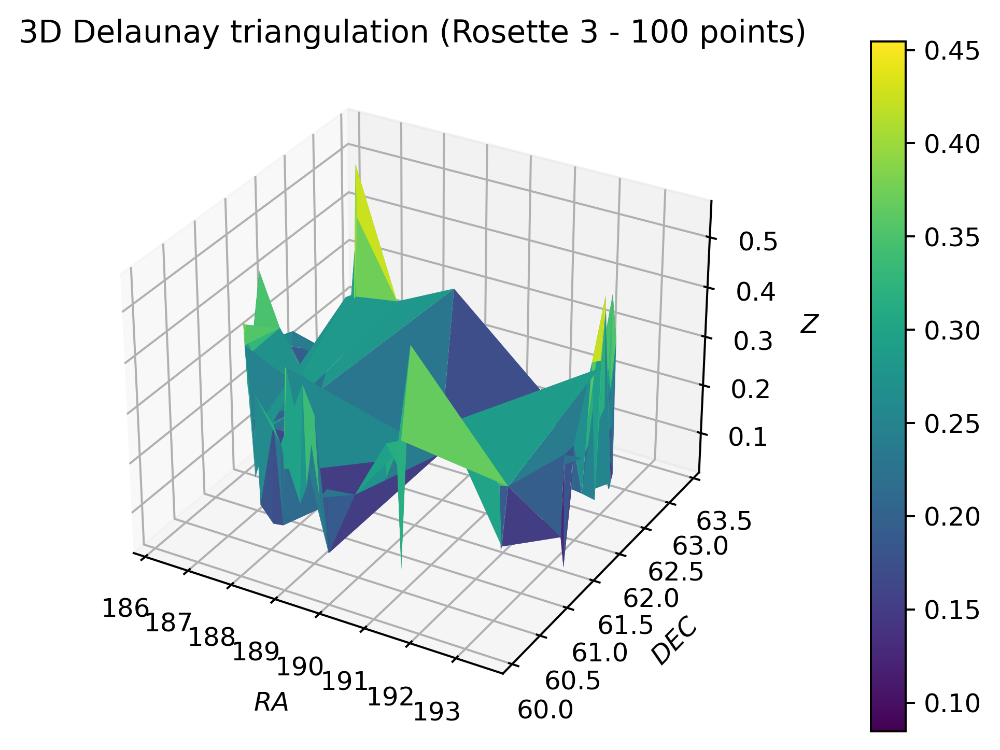

In [43]:
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
faceData = np.array(graph_dv(rosettes[0]))[:100]

trs = ax.plot_trisurf(
    faceData[:,0], faceData[:,1], faceData[:,2],
    triangles=Delaunay(faceData[:,:2]).simplices, cmap=cm.viridis)

fig.colorbar(trs, pad=0.14)
ax.set_title('3D Delaunay triangulation (Rosette 3 - 100 points)')
ax.set_xlabel(r'$RA$',)
ax.set_ylabel(r'$DEC$')
ax.set_zlabel(r'$Z$')
plt.show()

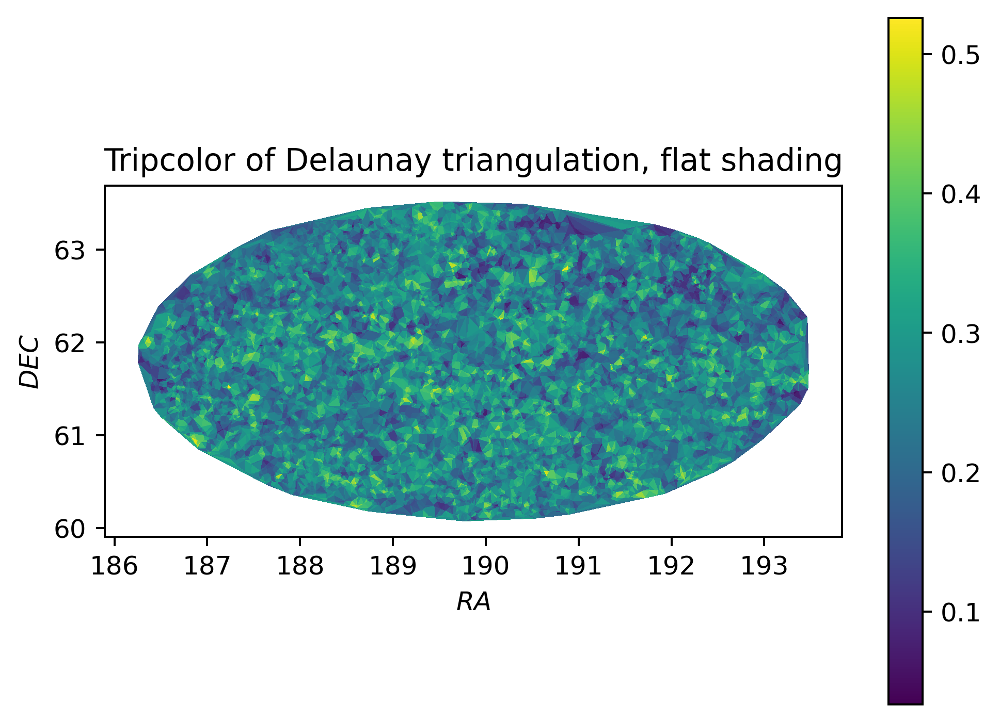

In [40]:
data = np.array(graph_dv(rosettes[0]))
triang = tri.Triangulation(data[:,0], data[:,1])

fig, ax = plt.subplots()
ax.set_aspect('equal')
tpc = ax.tripcolor(triang, data[:,2], shading='flat')
fig.colorbar(tpc)
ax.set_title('Tripcolor of Delaunay triangulation, flat shading')
ax.set_xlabel(r'$RA$',)
ax.set_ylabel(r'$DEC$')
plt.show()